In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [3]:
# read the dataset and display table information
df_21 = pd.read_csv('../data/clean/cleaned_df_21.csv')

In [4]:
display(df_21, df_21.info(), df_21.nunique())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46893 entries, 0 to 46892
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   country           46893 non-null  object 
 1   age_range         46893 non-null  object 
 2   employment        46893 non-null  object 
 3   education_level   46893 non-null  object 
 4   years_coding      46893 non-null  float64
 5   years_coding_pro  46893 non-null  float64
 6   type              46893 non-null  object 
 7   currency          46893 non-null  object 
 8   salary            46893 non-null  float64
dtypes: float64(3), object(6)
memory usage: 3.2+ MB


,country,age_range,employment,education_level,years_coding,years_coding_pro,type,currency,salary
0,Other,25-34 years old,Freelancer/Contractor,High School or Less,6.0,6.0,Other Developer,EUR,4800.0
1,Sweden,25-34 years old,"Employed, full-time",Master Degree,7.0,4.0,Data Scientist,SEK,42000.0
2,Spain,25-34 years old,"Employed, full-time",Bachelor Degree,12.0,5.0,Back-End Developer,EUR,43000.0
3,Germany,25-34 years old,"Employed, full-time",Master Degree,15.0,6.0,Back-End Developer,EUR,71500.0
4,Turkey,25-34 years old,"Employed, full-time",Bachelor Degree,6.0,2.0,Full Stack Developer,TRY,9000.0
...,...,...,...,...,...,...,...,...,...
46888,United States of America,25-34 years old,"Employed, full-time",Bachelor Degree,6.0,5.0,Back-End Developer,USD,160500.0
46889,Other,18-24 years old,Freelancer/Contractor,Bachelor Degree,4.0,2.0,Full Stack Developer,Other,200000.0
46890,United States of America,25-34 years old,"Employed, full-time",High School or Less,10.0,4.0,DevOps,USD,1800.0
46891,Canada,25-34 years old,"Employed, full-time",Bachelor Degree,5.0,3.0,Back-End Developer,CAD,90000.0


None

country               27
age_range              6
employment             6
education_level        5
years_coding          50
years_coding_pro      50
type                   9
currency              44
salary              3731
dtype: int64

In [4]:
#standardise currency to EUR

In [5]:
print(df_21['currency'].value_counts())

currency
USD      11664
EUR      11098
INR       3760
GBP       2954
Other     1742
CAD       1693
BRL       1508
PLN       1048
AUD        969
SEK        814
RUB        811
CHF        565
TRY        485
ILS        462
CZK        430
IRR        428
MXN        421
NOK        418
DKK        405
ZAR        368
PKR        327
NZD        321
ARS        295
CNY        290
UAH        270
RON        261
JPY        251
COP        239
IDR        233
BDT        232
HUF        231
BGN        226
EGP        168
PHP        157
NGN        155
LKR        155
TWD        152
MYR        146
SGD        143
CLP        129
VND        128
HRK        125
KRW        111
KES        105
Name: count, dtype: int64


In [6]:
# Exchange rates to EUR
exchange_rates = {
    'EUR': 1.00,
    'USD': 0.92,
    'GBP': 1.16,
    'INR': 0.011,
    'CAD': 0.67,
    'UAH': 0.025,
    'BRL': 0.18,
    'PLN': 0.21,
    'AUD': 0.59,
    'SEK': 0.086,
    'CHF': 1.04,
    'CZK': 0.041,
    'RUB': 0.0095,
    'DKK': 0.13,
    'NOK': 0.087,
    'ILS': 0.24,
    'NZD': 0.55,
    'ZAR': 0.049,
    'MXN': 0.052,
    'TRY': 0.034,
    'HUF': 0.0026,
    'RON': 0.20,
    'PKR': 0.0032,
    'BGN': 0.51,
    'IRR': 0.000022,
    'JPY': 0.0063,
    'BDT': 0.0086,
    'TWD': 0.029,
    'IDR': 0.000061,
    'COP': 0.00022,
    'CNY': 0.13
}

other_exchange_rates = {
    'NGN': 0.0012,
    'SGD': 0.64,
    'KRW': 0.0007,
    'VND': 0.000039,
    'ARS': 0.0026,
    'CLP': 0.0011,
    'HKD': 0.12,
    'AED': 0.25,
    'LKR': 0.0028,
    'PHP': 0.017,
    'RSD': 0.0085,
    'MYR': 0.21,
    'EGP': 0.029,
    'THB': 0.026,
    'KES': 0.0065,
    'NPR': 0.0071,
    'GEL': 0.35,
    'MAD': 0.090,
    'KZT': 0.002,
    'PEN': 0.23,
    'TND': 0.30,
    'UYU': 0.022,
    'AMD': 0.0018,
    'BAM': 0.51,
    'SAR': 0.25,
    'DOP': 0.016,
    'GHS': 0.079,
    'XOF': 0.0015,
    'PYG': 0.00014,
    'ETB': 0.017,
    'BOB': 0.13,
    'GTQ': 0.12,
    'UZS': 0.000079,
    'BYN': 0.37,
    'JOD': 1.29,
    'ISK': 0.0071,
    'AFN': 0.011,
    'CRC': 0.0017,
    'AZN': 0.53,
    'DZD': 0.0068,
    'MKD': 0.016,
    'MDL': 0.052,
    'IQD': 0.00063,
    'TZS': 0.00037,
    'UGX': 0.00024,
    'KGS': 0.010,
    'ALL': 0.0093,
    'MVR': 0.058,
    'MUR': 0.020,
    'RWF': 0.00080,
    'XAF': 0.0015,
    'HNL': 0.038,
    'FJD': 0.42,
    'SYP': 0.00040,
    'MGA': 0.00020,
    'TMT': 0.27,
    'ZMW': 0.048,
    'MMK': 0.00044,
    'BHD': 2.44,
    'JMD': 0.0060,
    'QAR': 0.25,
    'AOA': 0.0011,
    'TTD': 0.14,
    'MNT': 0.00027,
    'MWK': 0.00080,
    'MZN': 0.014,
    'NIO': 0.025,
    'KWD': 3.04,
    'XPF': 0.0084,
    'OMR': 2.40,
    'YER': 0.0037,
    'VES': 0.000025,
    'GGP': 1.16,
    'ANG': 0.51,
    'NAD': 0.049,
    'BTN': 0.011,
    'MOP': 0.11,
    'BIF': 0.00035,
    'KHR': 0.00022,
    'CUP': 0.036,
    'TJS': 0.083,
    'MRU': 0.024,
    'CVE': 0.0091,
    'SRD': 0.025,
    'SZL': 0.049,
    'BWP': 0.069,
    'FKP': 1.16,
    'BND': 0.64,
    'WST': 0.34,
    'IMP': 1.16,
    'XDR': 1.29,
    'SOS': 0.0016,
    'LBP': 0.00006,
    'BSD': 0.92,
    'LYD': 0.19,
    'SLL': 0.000043,
    'GYD': 0.0044,
    'KPW': 0.00092,
    'AWG': 0.51
}
other_median_rate = pd.Series(list(other_exchange_rates.values())).median()

# Apply the conversion to EUR for each row
df_21['salary_eur'] = df_21.apply(lambda row: row['salary'] * exchange_rates.get(row['currency'], other_median_rate if row['currency'] == 'Other' else exchange_rates.get(row['currency'], 1)), axis=1)

# Verify the new column
df_21[['currency', 'salary', 'salary_eur']].tail(30)

,currency,salary,salary_eur
46863,BRL,300000.0,54000.0
46864,INR,683000.0,7513.0
46865,EUR,2800.0,2800.0
46866,INR,2000000.0,22000.0
46867,USD,70000.0,64400.0
46868,KRW,1860000.0,1860000.0
46869,USD,85000.0,78200.0
46870,Other,120000.0,2400.0
46871,EUR,80000.0,80000.0
46872,INR,3500000.0,38500.0


In [7]:
print(df_21['currency'].value_counts())

currency
USD      11664
EUR      11098
INR       3760
GBP       2954
Other     1742
CAD       1693
BRL       1508
PLN       1048
AUD        969
SEK        814
RUB        811
CHF        565
TRY        485
ILS        462
CZK        430
IRR        428
MXN        421
NOK        418
DKK        405
ZAR        368
PKR        327
NZD        321
ARS        295
CNY        290
UAH        270
RON        261
JPY        251
COP        239
IDR        233
BDT        232
HUF        231
BGN        226
EGP        168
PHP        157
NGN        155
LKR        155
TWD        152
MYR        146
SGD        143
CLP        129
VND        128
HRK        125
KRW        111
KES        105
Name: count, dtype: int64


In [8]:
display(df_21)

,country,age_range,employment,education_level,years_coding,years_coding_pro,type,currency,salary,salary_eur
0,Other,25-34 years old,Freelancer/Contractor,High School or Less,6.0,6.0,Other Developer,EUR,4800.0,4800.0
1,Sweden,25-34 years old,"Employed, full-time",Master Degree,7.0,4.0,Data Scientist,SEK,42000.0,3612.0
2,Spain,25-34 years old,"Employed, full-time",Bachelor Degree,12.0,5.0,Back-End Developer,EUR,43000.0,43000.0
3,Germany,25-34 years old,"Employed, full-time",Master Degree,15.0,6.0,Back-End Developer,EUR,71500.0,71500.0
4,Turkey,25-34 years old,"Employed, full-time",Bachelor Degree,6.0,2.0,Full Stack Developer,TRY,9000.0,306.0
...,...,...,...,...,...,...,...,...,...,...
46888,United States of America,25-34 years old,"Employed, full-time",Bachelor Degree,6.0,5.0,Back-End Developer,USD,160500.0,147660.0
46889,Other,18-24 years old,Freelancer/Contractor,Bachelor Degree,4.0,2.0,Full Stack Developer,Other,200000.0,4000.0
46890,United States of America,25-34 years old,"Employed, full-time",High School or Less,10.0,4.0,DevOps,USD,1800.0,1656.0
46891,Canada,25-34 years old,"Employed, full-time",Bachelor Degree,5.0,3.0,Back-End Developer,CAD,90000.0,60300.0


In [9]:
print(df_21['country'].value_counts())

country
United States of America                                9856
Other                                                   9671
India                                                   3873
Germany                                                 3244
United Kingdom of Great Britain and Northern Ireland    2921
Canada                                                  1728
France                                                  1639
Brazil                                                  1585
Poland                                                  1113
Netherlands                                             1064
Spain                                                   1035
Australia                                                955
Italy                                                    936
Russian Federation                                       878
Sweden                                                   830
Switzerland                                              556
Turkey          

In [10]:
# Rename specific country values for simplificity
df_21['country'] = df_21['country'].replace({
    'United States of America': 'United States',
    'United Kingdom of Great Britain and Northern Ireland': 'United Kingdom'
})
print(df_21['country'].value_counts())

country
United States                   9856
Other                           9671
India                           3873
Germany                         3244
United Kingdom                  2921
Canada                          1728
France                          1639
Brazil                          1585
Poland                          1113
Netherlands                     1064
Spain                           1035
Australia                        955
Italy                            936
Russian Federation               878
Sweden                           830
Switzerland                      556
Turkey                           541
Israel                           485
Ukraine                          470
Iran, Islamic Republic of...     467
Mexico                           459
Austria                          455
Czech Republic                   454
Belgium                          430
Norway                           426
Denmark                          411
Argentina                     

# viewing

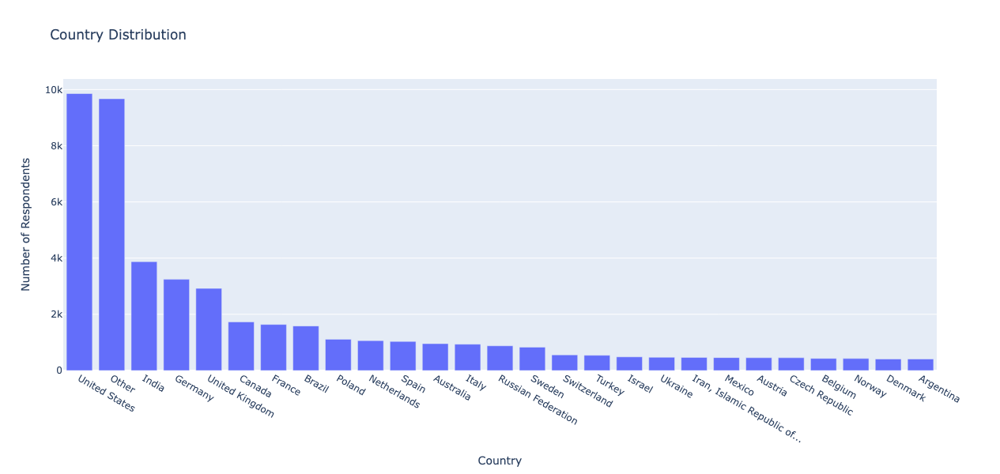

In [11]:
# Get the value counts for the 'country' column
country_distribution = df_21['country'].value_counts().reset_index()
country_distribution.columns = ['country', 'count']

# Create a bar chart for country distribution
fig = px.bar(country_distribution, x='country', y='count', 
             title='Country Distribution',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis={'categoryorder':'total descending'}, xaxis_title='Country', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

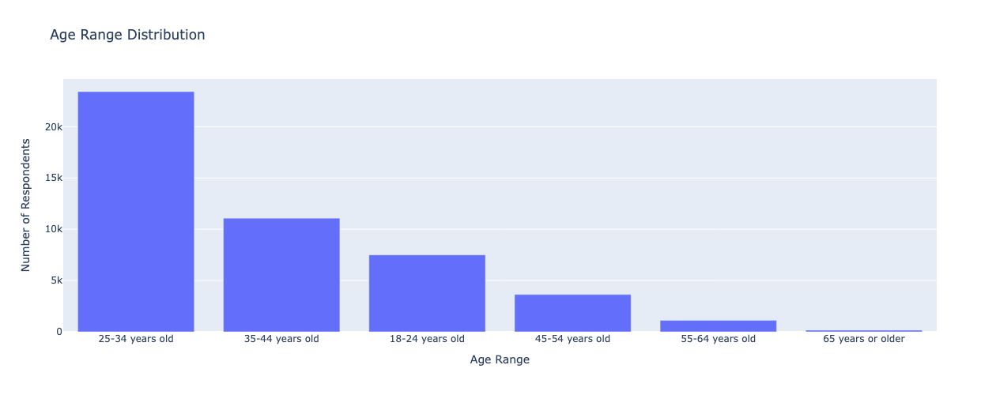

In [12]:
# Get the value counts for the 'age_range' column
age_range_distribution = df_21['age_range'].value_counts().reset_index()
age_range_distribution.columns = ['age_range', 'count']

# Create a bar chart for age range distribution
fig = px.bar(age_range_distribution, x='age_range', y='count', 
             title='Age Range Distribution',
             labels={'count': 'Number of Respondents', 'age_range': 'Age Range'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Age Range', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

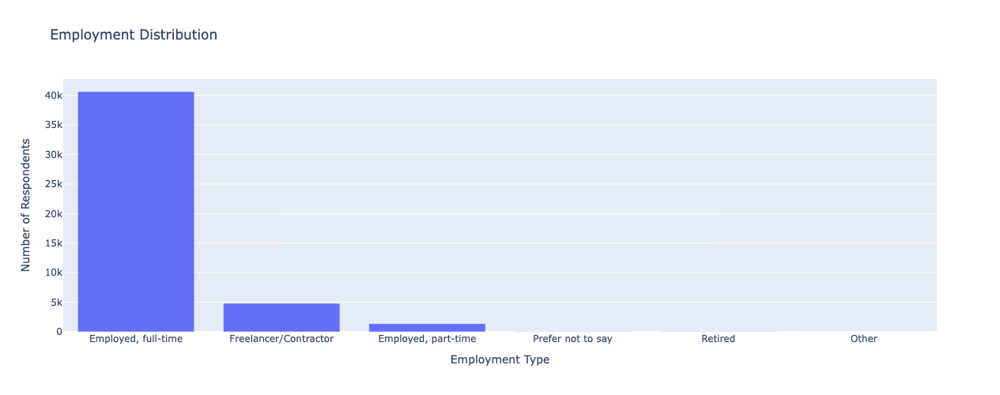

In [13]:
# Get the value counts for the 'employment' column
employment_distribution = df_21['employment'].value_counts().reset_index()
employment_distribution.columns = ['employment', 'count']

# Create a bar chart for employment distribution
fig = px.bar(employment_distribution, x='employment', y='count', 
             title='Employment Distribution',
             labels={'count': 'Number of Respondents', 'employment': 'Employment Type'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Employment Type', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [15]:
# NO WORK LOCATION COLUMN
# Get the value counts for the 'work_location' column
#work_location_distribution = df_21['work_location'].value_counts().reset_index()
#work_location_distribution.columns = ['work_location', 'count']

# Create a bar chart for work location distribution
#fig = px.bar(work_location_distribution, x='work_location', y='count', 
 #            title='Work Location Distribution',
  #           labels={'count': 'Number of Respondents', 'work_location': 'Work Location'},
   #          width=800, height=500)

# Update layout for better visualization
#fig.update_layout(xaxis_title='Work Location', yaxis_title='Number of Respondents')
#
# Display the plot
#fig.show()

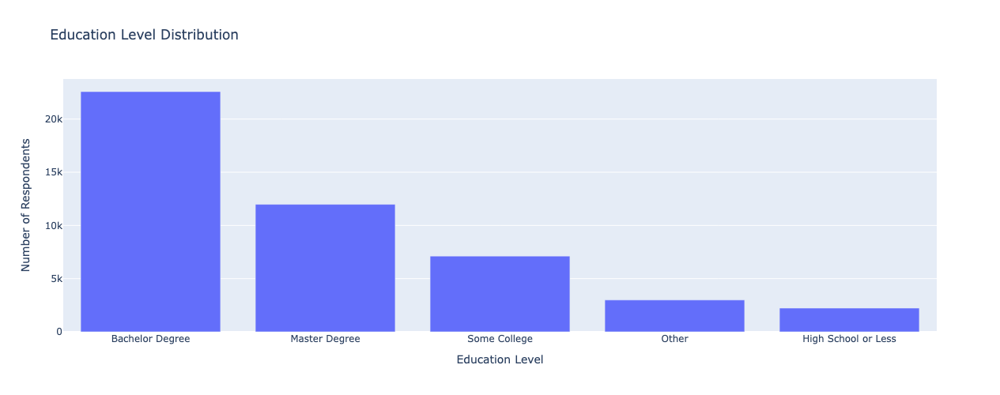

In [17]:
# Get the value counts for the 'education_level' column
education_level_distribution = df_21['education_level'].value_counts().reset_index()
education_level_distribution.columns = ['education_level', 'count']

# Create a bar chart for education level distribution
fig = px.bar(education_level_distribution, x='education_level', y='count', 
             title='Education Level Distribution',
             labels={'count': 'Number of Respondents', 'education_level': 'Education Level'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Education Level', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

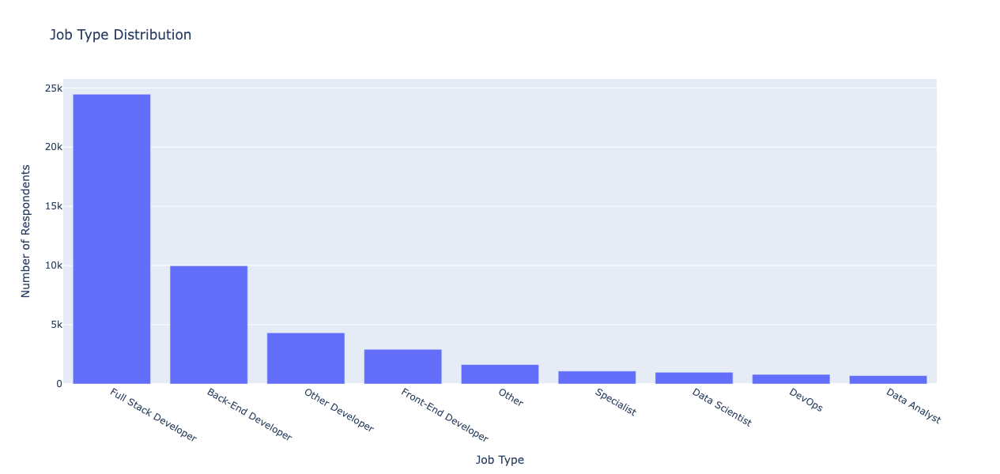

In [18]:
# Get the value counts for the 'type' column
type_distribution = df_21['type'].value_counts().reset_index()
type_distribution.columns = ['type', 'count']

# Create a bar chart for type distribution
fig = px.bar(type_distribution, x='type', y='count', 
             title='Job Type Distribution',
             labels={'count': 'Number of Respondents', 'type': 'Job Type'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis_title='Job Type', yaxis_title='Number of Respondents', 
                  xaxis={'categoryorder':'total descending'})

# Display the plot
fig.show()

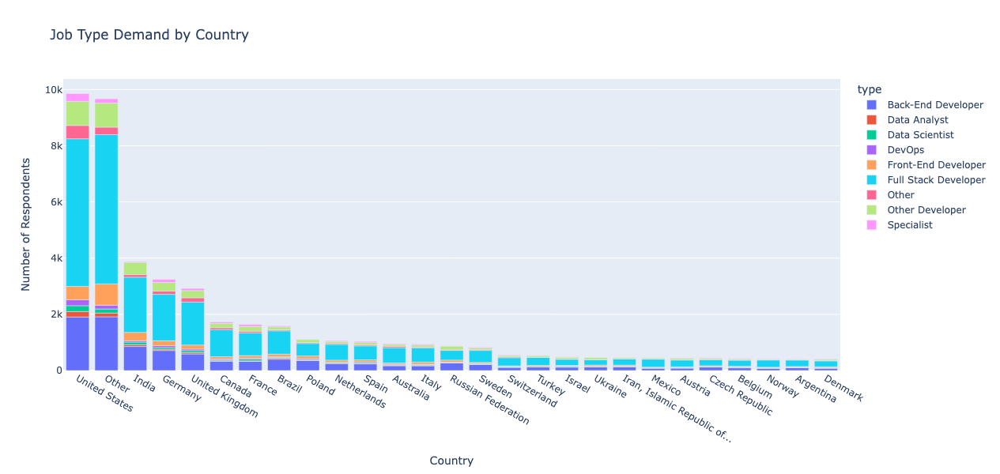

In [19]:
# Count of job types by country
job_type_country = df_21.groupby(['country', 'type']).size().reset_index(name='count')

fig = px.bar(job_type_country, x='country', y='count', color='type', 
             title='Job Type Demand by Country',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Country', yaxis_title='Number of Respondents', xaxis={'categoryorder':'total descending'})
fig.show()

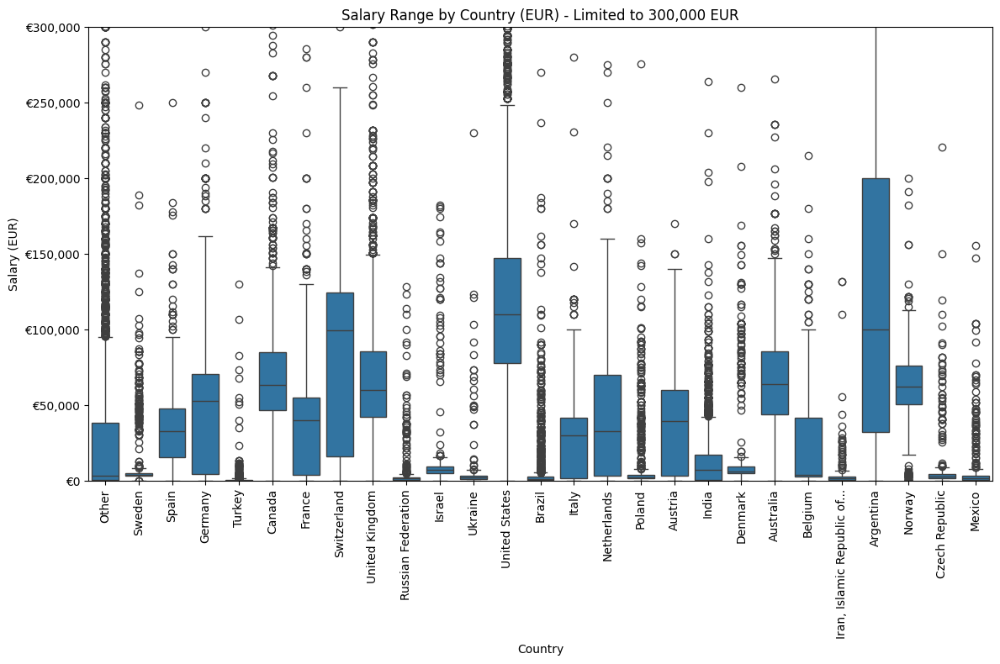

In [20]:
import matplotlib.ticker as mticker

# Set the figure size
plt.figure(figsize=(12, 8))

# Create a box plot for salary range vs country
sns.boxplot(x='country', y='salary_eur', data=df_21)

# Rotate the x-axis labels for better readability
plt.xticks(rotation=90)

# Set the title and labels
plt.title('Salary Range by Country (EUR) - Limited to 300,000 EUR')
plt.xlabel('Country')
plt.ylabel('Salary (EUR)')

# Limit the y-axis to a maximum of 300,000 EUR
plt.ylim(0, 300000)

# Format the y-axis to show proper salary values
plt.gca().yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, _: f'€{x:,.0f}'))

# Show the plot
plt.tight_layout()
plt.show()

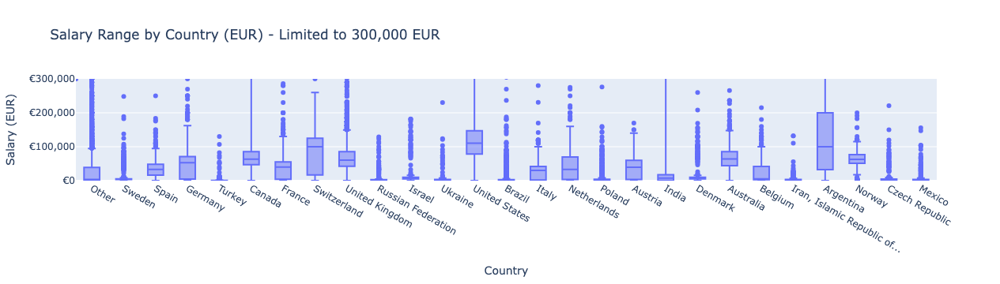

In [21]:
import plotly.express as px

# Create a box plot for salary range vs country
fig = px.box(df_21, x='country', y='salary_eur', 
             title='Salary Range by Country (EUR) - Limited to 300,000 EUR',
             labels={'salary_eur': 'Salary (EUR)', 'country': 'Country'})

# Limit the y-axis to a maximum of 300,000 EUR
fig.update_layout(yaxis=dict(range=[0, 300000]))

# Update y-axis formatting to include proper salary display
fig.update_yaxes(tickprefix='€', tickformat=',.0f')

# Display the plot
fig.show()

In [22]:
# check the salariy column and unusual high max values
# Filter the rows where salary_eur is greater than 300,000
high_salary_df = df_21[df_21['salary_eur'] > 300000][['country', 'currency', 'salary', 'salary_eur']]

# Display the filtered rows
display(high_salary_df, high_salary_df['country'].value_counts())

,country,currency,salary,salary_eur
26,United States,USD,5.000000e+05,4.600000e+05
48,United States,Other,1.000000e+29,2.000000e+27
126,Other,CLP,1.500000e+06,1.500000e+06
269,Argentina,ARS,1.725000e+07,1.725000e+07
308,United States,USD,4.300000e+05,3.956000e+05
...,...,...,...,...
46762,United States,USD,4.000000e+05,3.680000e+05
46783,United States,USD,6.000000e+05,5.520000e+05
46848,United States,USD,3.700000e+05,3.404000e+05
46857,Other,CLP,2.000000e+06,2.000000e+06


country
Other                           523
United States                   307
Argentina                        58
United Kingdom                   18
Canada                           13
Germany                           9
India                             8
France                            6
Switzerland                       4
Netherlands                       3
Australia                         1
Ukraine                           1
Belgium                           1
Brazil                            1
Italy                             1
Israel                            1
Spain                             1
Norway                            1
Iran, Islamic Republic of...      1
Name: count, dtype: int64

In [23]:
# decided to drop rows where salary_eur exceed 300,000 and focus on where the real range lies
# Drop rows where salary_eur is greater than 300,000
df_21_cleaned = df_21[df_21['salary_eur'] <= 300000]

# Verify the number of rows after filtering
print(df_21_cleaned.shape)

# Display a sample of the cleaned data
print(df_21_cleaned[['country', 'currency', 'salary', 'salary_eur']].head())

(45935, 10)
   country currency   salary  salary_eur
0    Other      EUR   4800.0      4800.0
1   Sweden      SEK  42000.0      3612.0
2    Spain      EUR  43000.0     43000.0
3  Germany      EUR  71500.0     71500.0
4   Turkey      TRY   9000.0       306.0


---

# EDA Analysis:

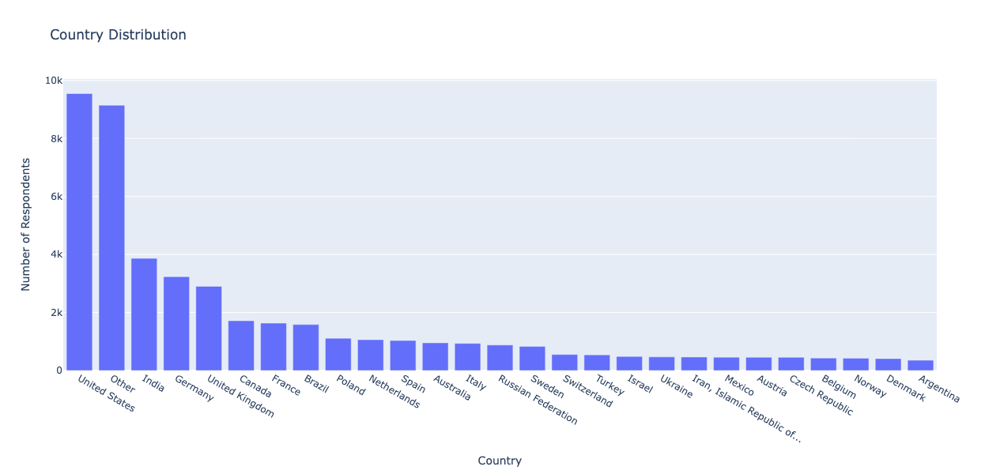

In [24]:
# Get the value counts for the 'country' column
country_distribution = df_21_cleaned['country'].value_counts().reset_index()
country_distribution.columns = ['country', 'count']

# Create a bar chart for country distribution
fig = px.bar(country_distribution, x='country', y='count', 
             title='Country Distribution',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis={'categoryorder':'total descending'}, xaxis_title='Country', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

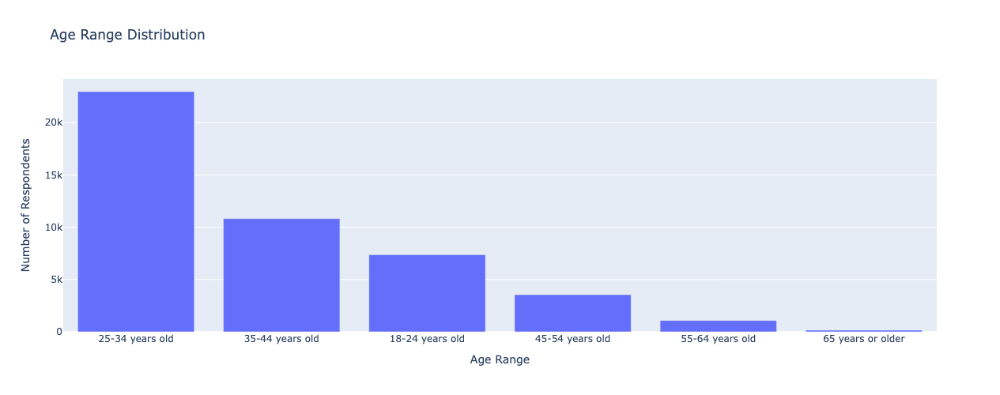

In [25]:
# Get the value counts for the 'age_range' column
age_range_distribution = df_21_cleaned['age_range'].value_counts().reset_index()
age_range_distribution.columns = ['age_range', 'count']

# Create a bar chart for age range distribution
fig = px.bar(age_range_distribution, x='age_range', y='count', 
             title='Age Range Distribution',
             labels={'count': 'Number of Respondents', 'age_range': 'Age Range'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Age Range', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

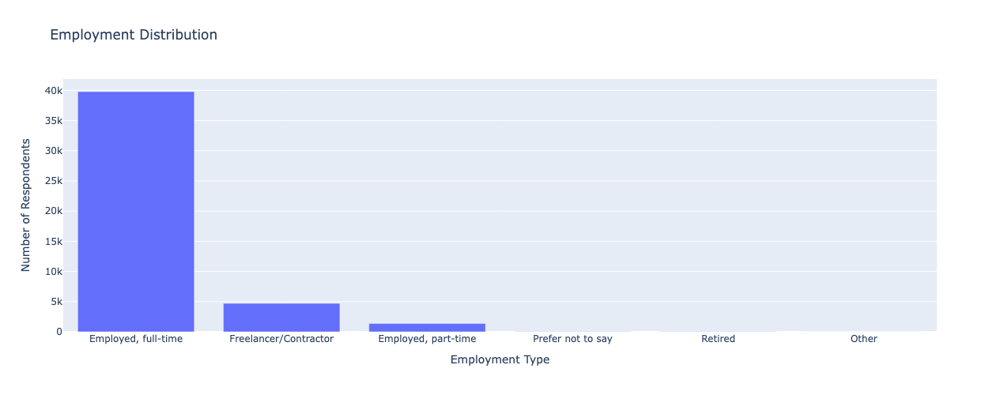

In [28]:
# Get the value counts for the 'employment' column
employment_distribution = df_21_cleaned['employment'].value_counts().reset_index()
employment_distribution.columns = ['employment', 'count']

# Create a bar chart for employment distribution
fig = px.bar(employment_distribution, x='employment', y='count', 
             title='Employment Distribution',
             labels={'count': 'Number of Respondents', 'employment': 'Employment Type'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Employment Type', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

In [29]:
# Get the value counts for the 'work_location' column
#work_location_distribution = df_21_cleaned['work_location'].value_counts().reset_index()
#work_location_distribution.columns = ['work_location', 'count']

# Create a bar chart for work location distribution
#fig = px.bar(work_location_distribution, x='work_location', y='count', 
#             title='Work Location Distribution',
#             labels={'count': 'Number of Respondents', 'work_location': 'Work Location'},
#             width=800, height=500)

# Update layout for better visualization
#fig.update_layout(xaxis_title='Work Location', yaxis_title='Number of Respondents')

# Display the plot
#fig.show()

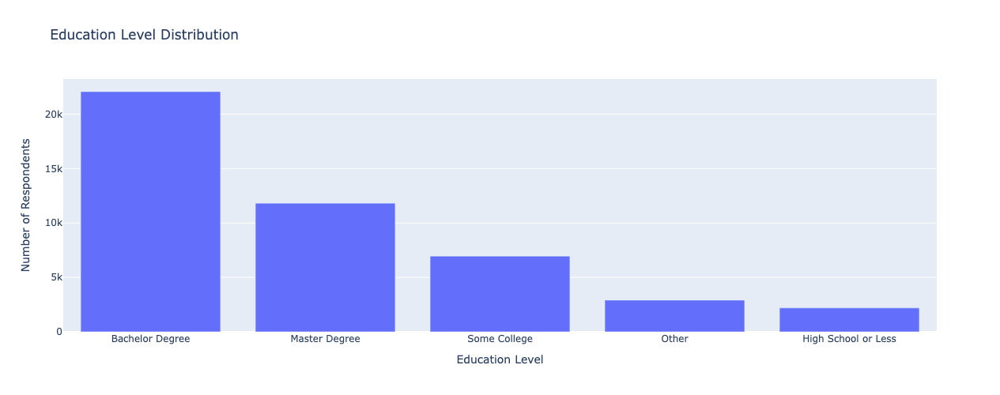

In [30]:
# Get the value counts for the 'education_level' column
education_level_distribution = df_21_cleaned['education_level'].value_counts().reset_index()
education_level_distribution.columns = ['education_level', 'count']

# Create a bar chart for education level distribution
fig = px.bar(education_level_distribution, x='education_level', y='count', 
             title='Education Level Distribution',
             labels={'count': 'Number of Respondents', 'education_level': 'Education Level'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Education Level', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

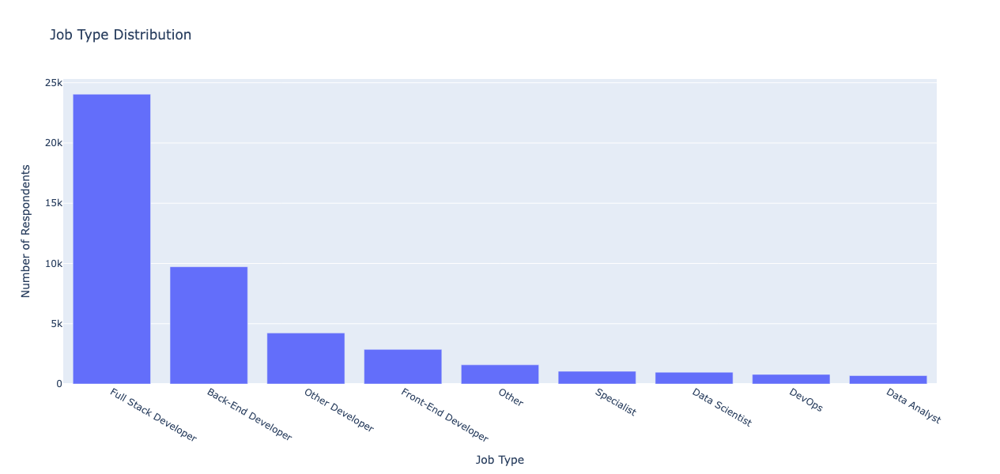

In [31]:
# Get the value counts for the 'type' column
type_distribution = df_21_cleaned['type'].value_counts().reset_index()
type_distribution.columns = ['type', 'count']

# Create a bar chart for type distribution
fig = px.bar(type_distribution, x='type', y='count', 
             title='Job Type Distribution',
             labels={'count': 'Number of Respondents', 'type': 'Job Type'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis_title='Job Type', yaxis_title='Number of Respondents', 
                  xaxis={'categoryorder':'total descending'})

# Display the plot
fig.show()

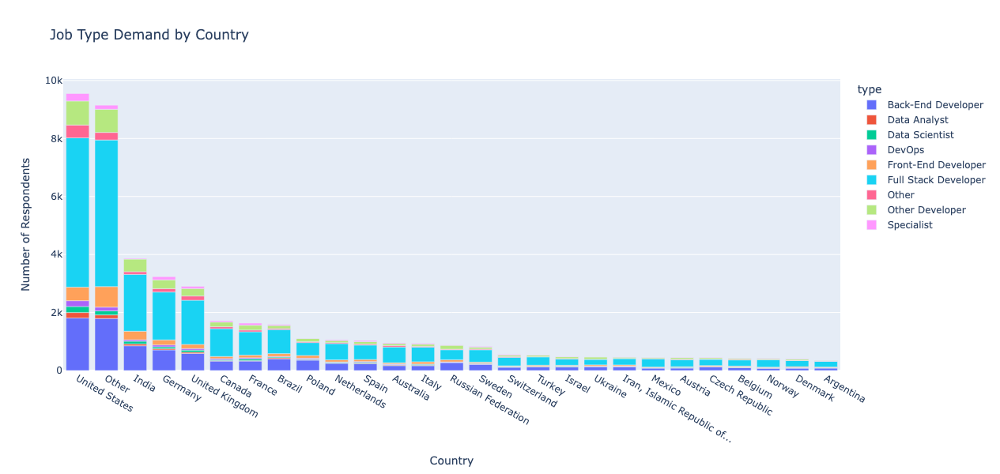

In [32]:
# Count of job types by country
job_type_country = df_21_cleaned.groupby(['country', 'type']).size().reset_index(name='count')

fig = px.bar(job_type_country, x='country', y='count', color='type', 
             title='Job Type Demand by Country',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Country', yaxis_title='Number of Respondents', xaxis={'categoryorder':'total descending'})
fig.show()

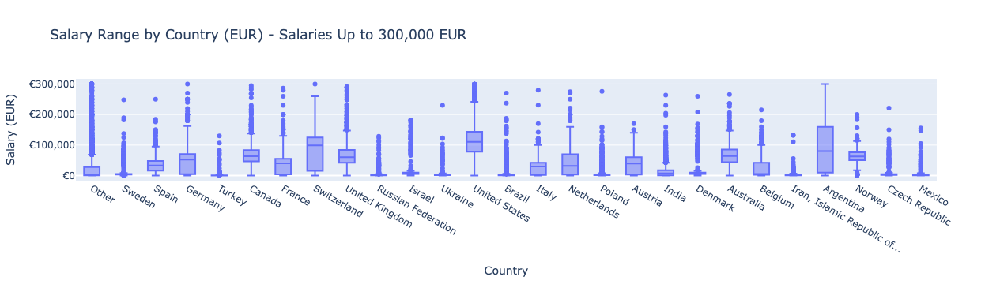

In [33]:
# Create a box plot for salary range vs country using the cleaned data
fig = px.box(df_21_cleaned, x='country', y='salary_eur', 
             title='Salary Range by Country (EUR) - Salaries Up to 300,000 EUR',
             labels={'salary_eur': 'Salary (EUR)', 'country': 'Country'})

# Update y-axis formatting to include proper salary display
fig.update_yaxes(tickprefix='€', tickformat=',.0f')

# Display the plot
fig.show()

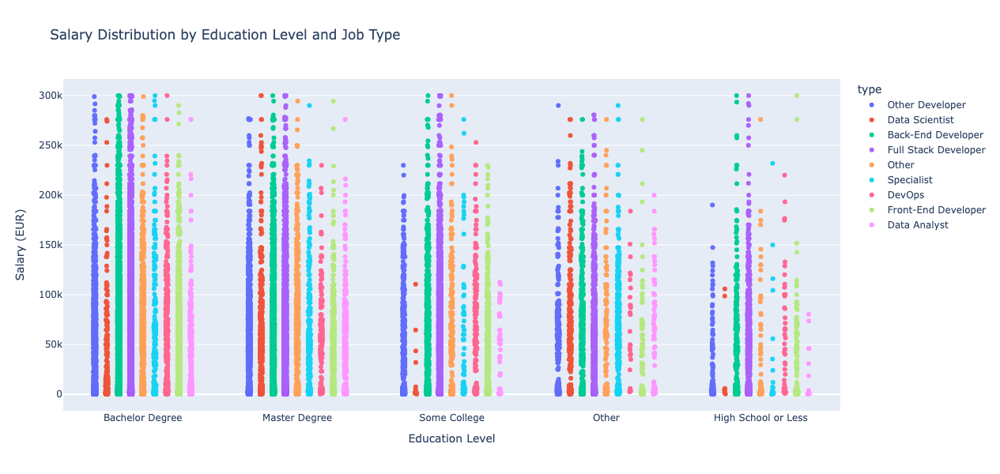

In [34]:
fig = px.strip(df_21_cleaned, x='education_level', y='salary_eur', color='type', 
               title='Salary Distribution by Education Level and Job Type',
               labels={'salary_eur': 'Salary (EUR)', 'education_level': 'Education Level'},
               hover_data=['type'],
               width=1000, height=600)

fig.update_layout(xaxis_title='Education Level', yaxis_title='Salary (EUR)', xaxis={'categoryorder':'total descending'})
fig.show()

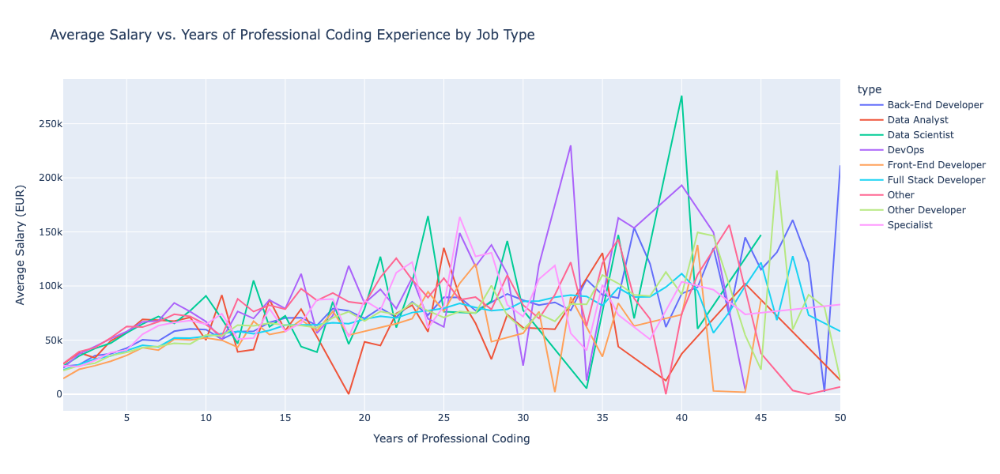

In [35]:
# Group by years of coding and job type to get average salary
salary_experience = df_21_cleaned.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

fig = px.line(salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience by Job Type',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

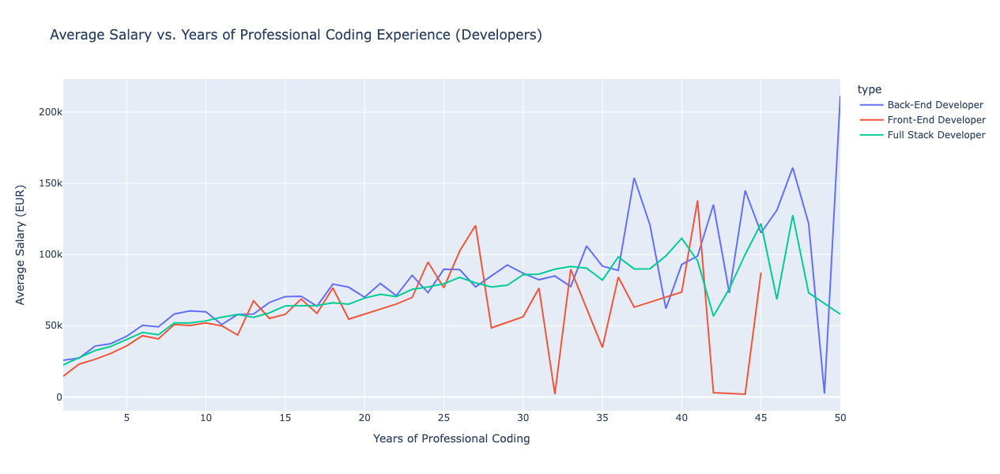

In [36]:
# Define the job types for developers
developer_types = ['Full Stack Developer', 'Back-End Developer', 'Front-End Developer']

# Filter the dataset for developers
developer_salary_experience = df_21_cleaned[df_21_cleaned['type'].isin(developer_types)]

# Group by years of coding and job type to get average salary for developers
developer_salary_experience = developer_salary_experience.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

# Plot the graph for developers
fig = px.line(developer_salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience (Developers)',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

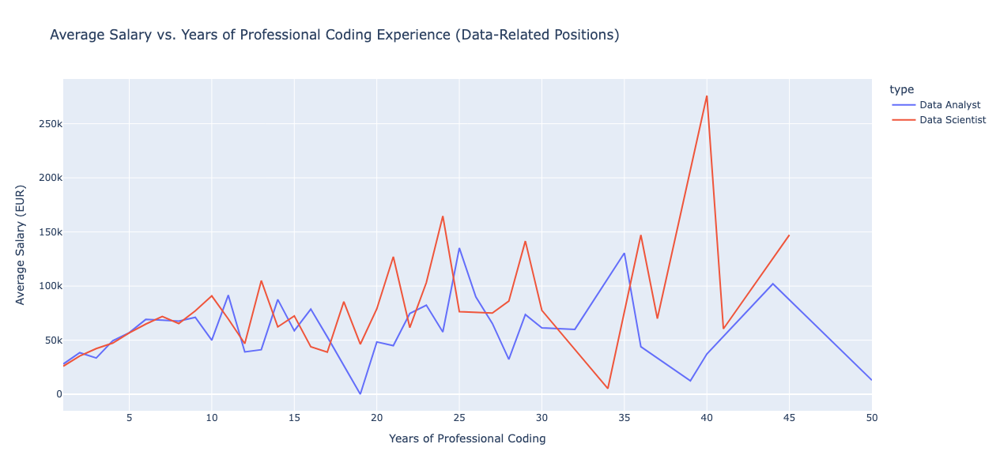

In [37]:
# Define the job types for data-related positions
data_related_types = ['Data Scientist', 'Data Engineer', 'Data Analyst', 'Machine Learning Specialist']

# Filter the dataset for data-related positions
data_salary_experience = df_21_cleaned[df_21_cleaned['type'].isin(data_related_types)]

# Group by years of coding and job type to get average salary for data-related positions
data_salary_experience = data_salary_experience.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

# Plot the graph for data-related positions
fig = px.line(data_salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience (Data-Related Positions)',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

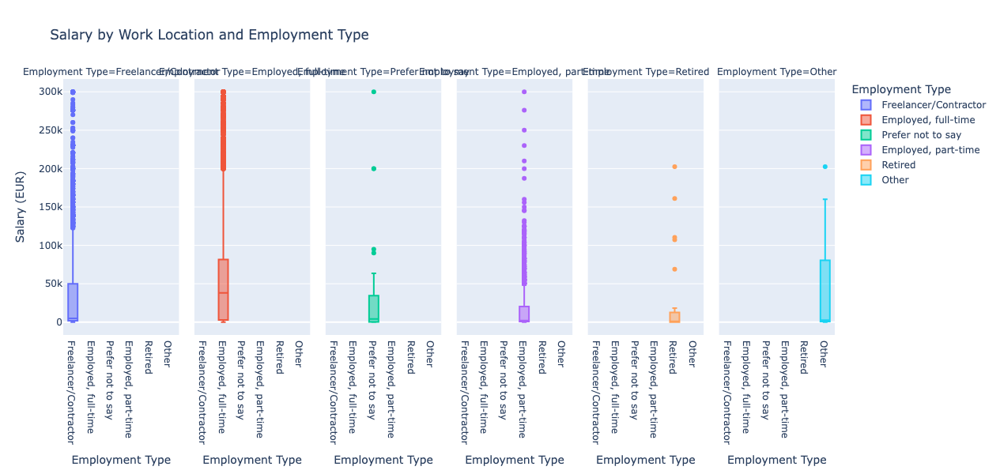

In [39]:
fig = px.box(df_21_cleaned, x='employment', y='salary_eur', color='employment',
             facet_col='employment', title='Salary by Work Location and Employment Type',
             labels={'salary_eur': 'Salary (EUR)', 'employment': 'Employment Type'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Employment Type', yaxis_title='Salary (EUR)')
fig.show()

In [40]:
# Make a copy of the cleaned table
df_21_cleaned.to_csv('final_df_21.csv', index=False)